### Librerias

In [229]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from datetime import date, time, datetime
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from hdbcli import dbapi as db

from statsmodels.tsa.api import STLForecast, ExponentialSmoothing, ExponentialSmoothing

from sklearn.metrics import mean_squared_error as MSE
from sklearn.metrics import mean_absolute_percentage_error as MAPE
from sklearn.metrics import r2_score

from statsmodels.tsa.api import STLForecast, ExponentialSmoothing, ETSModel

import warnings
warnings.filterwarnings('ignore')

from prophet import Prophet

import xgboost as xgb
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_fscore_support as score

from sklearn.model_selection import GridSearchCV
from xgboost import XGBRegressor

from pmdarima.arima import auto_arima
from statsmodels.tsa.api import STLForecast
from statsmodels.tsa.arima.model import ARIMA


import pandas as pd
import smtplib
from email.mime.text import MIMEText
from email.mime.multipart import MIMEMultipart
from email.mime.application import MIMEApplication
from openpyxl import Workbook

import pandas as pd
import smtplib
from email.mime.text import MIMEText
from email.mime.multipart import MIMEMultipart
from email.mime.application import MIMEApplication
from openpyxl import Workbook

from dateutil.relativedelta import relativedelta

### Base de datos

In [2]:
conn = db.connect(address='10.0.0.110', port='30015', user='DESARROLLO', password='DevHermeco.2022')
cursor = conn.cursor()
sql = '''SELECT "AÑO",
"CANAL",
"MES",
"MATERIAL",
"AFS: COLOR",
"AFS: TALLA", 
"UNIDADES", 
"Sublínea",
"Mundo",
"Tipo de Artículo", 
"Concepto Diseño",
"Año de Venta", 
"Mes de Venta", 
"FECHA VENTA"
FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 \
WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS')
AND "AÑO" >= 2018
'''
df_canal = pd.read_sql_query(sql, conn)

In [7]:
df_dummies = pd.get_dummies(all2023['REGIÓN'], prefix='region')

In [8]:
df_dummies[]

,region_AMAZONAS,region_ANTIOQUIA,region_ARAUCA,region_ATLÁNTICO,region_BOGOTÁ,region_BOLÍVAR,region_BOYACA,region_CALDAS,region_CAQUETA,region_CASANARE,...,region_PUTUMAYO,region_QUINDIO,region_RISARALDA,region_SAN ANDRÉS,region_SANTANDER,region_SUCRE,region_TOLIMA,region_VALLE,region_VAUPES,region_VICHADA
0,False,False,False,False,False,False,False,False,False,False,...,False,False,True,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,True,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
4,False,False,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
312409,False,False,False,False,False,False,False,False,False,False,...,False,False,True,False,False,False,False,False,False,False
312410,False,False,False,False,False,False,False,False,False,False,...,False,False,True,False,False,False,False,False,False,False
312411,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
312412,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False


In [11]:
all2023[all2023['UNIDADES'] !=1]

,# Factura,# Pedido,Clase Fact.,D. Clase Fact.,Sociedad,CeBe,Nombre Sociedad,Descripcion Sociedad,Ciudad,C. Org. Vtas,...,Concepto Diseño,Colección,SOLICITANTE,País,REGIÓN,CANAL,SEMANA,VALOR VENTA POS,COSTO,FECHA VENTA


In [12]:
all2023.groupby('FECHA VENTA')['UNIDADES'].sum()

FECHA VENTA
2023-01-01     168.0
2023-01-02    2518.0
2023-01-03    2694.0
2023-01-04    2484.0
2023-01-05    2309.0
               ...  
2023-04-28    3597.0
2023-04-29    7307.0
2023-04-30    4507.0
2023-05-01    3327.0
2023-05-02     782.0
Name: UNIDADES, Length: 122, dtype: float64

In [81]:
all2023['Marca'].unique()

array(['OFFCORSS', 'ALETA'], dtype=object)

In [60]:
all2023[all2023['Marca']=='ALETA']

,# Factura,# Pedido,Clase Fact.,D. Clase Fact.,Sociedad,CeBe,Nombre Sociedad,Descripcion Sociedad,Ciudad,C. Org. Vtas,...,Concepto Diseño,Colección,SOLICITANTE,País,REGIÓN,CANAL,SEMANA,VALOR VENTA POS,COSTO,FECHA VENTA
1260,0374761560,1011633686,ZPOS,Factura POS Bol Vtas,2000,CB130126,OUTLET PLAZUELA 23,FRANQUICIAS COLOMBIANAS,SANTA MARTA,2010,...,COLECCION 1,0,,CO,MAGDALENA,FRANQUICIAS,16,18903.0,13901.0,2023-04-11
1261,0670922090,1011604333,ZPOS,Factura POS Bol Vtas,2000,CB130117,MAREDU S.A.S,FRANQUICIAS COLOMBIANAS,DOSQUEBRADAS,2130,...,COLECCION 1,0,,CO,RISARALDA,FRANQUICIAS,14,18903.0,13901.0,2023-03-31
1262,0374760635,1011476693,ZPOS,Factura POS Bol Vtas,2000,CB130126,OUTLET PLAZUELA 23,FRANQUICIAS COLOMBIANAS,SANTA MARTA,2010,...,COLECCION 1,0,,CO,MAGDALENA,FRANQUICIAS,5,18903.0,13901.0,2023-01-23
1263,0398949392,1011683734,ZPOS,Factura POS Bol Vtas,2000,CB130123,OUTLET UNICO BARRANQUILLA,FRANQUICIAS COLOMBIANAS,BARRANQUILLA,2010,...,COLECCION 1,0,,CO,ATLÁNTICO,FRANQUICIAS,18,18903.0,13901.0,2023-04-30
1264,0670922843,1011670819,ZPOS,Factura POS Bol Vtas,2000,CB130117,MAREDU S.A.S,FRANQUICIAS COLOMBIANAS,DOSQUEBRADAS,2130,...,COLECCION 1,0,,CO,VALLE,FRANQUICIAS,18,18903.0,13901.0,2023-04-27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
308034,0374760753,1011495411,ZPOS,Factura POS Bol Vtas,2000,CB130126,OUTLET PLAZUELA 23,FRANQUICIAS COLOMBIANAS,SANTA MARTA,2010,...,COLECCION 2,0,,CO,ATLÁNTICO,FRANQUICIAS,6,21004.0,14749.0,2023-02-03
308035,0398949333,1011674449,ZPOS,Factura POS Bol Vtas,2000,CB130123,OUTLET UNICO BARRANQUILLA,FRANQUICIAS COLOMBIANAS,BARRANQUILLA,2010,...,COLECCION 2,0,,CO,ATLÁNTICO,FRANQUICIAS,18,21004.0,14749.0,2023-04-29
308036,0374761395,1011605798,ZPOS,Factura POS Bol Vtas,2000,CB130126,OUTLET PLAZUELA 23,FRANQUICIAS COLOMBIANAS,SANTA MARTA,2010,...,COLECCION 2,0,,CO,MAGDALENA,FRANQUICIAS,14,21004.0,14749.0,2023-03-31
308037,0670921492,1011562784,ZPOS,Factura POS Bol Vtas,2000,CB130117,MAREDU S.A.S,FRANQUICIAS COLOMBIANAS,DOSQUEBRADAS,2130,...,COLECCION 2,0,,CO,RISARALDA,FRANQUICIAS,11,21004.0,14749.0,2023-03-11


In [5]:
all2023 = pd.read_parquet('all2023.parquet')

In [6]:
all2023['Sociedad-Canal'].unique()

array(['2130-51', '2010-50', '2130-50', '1010-10', '2120-50', '2090-50',
       '2110-50', '2040-50', '2050-50', '2060-50', '2010-51', '2140-50'],
      dtype=object)

In [82]:
all2023['Edad'].unique()

array(['NIÑOS', 'PRIMI', 'MASCOTAS', 'BEBES', 'OTROS'], dtype=object)

In [70]:
all2023['Mundo'].unique()

array(['NIÑO', 'NIÑA', 'PRIMI NIÑA', 'MASCOTAS', 'BEBÉ NIÑA', 'BEBÉ NIÑO',
       'PRIMI NIÑO', 'OTROS'], dtype=object)

In [230]:
all2023.info()

In [86]:
def head_tail(df,n): #Función par ver primeros y últimos registros
    return pd.concat([df.head(n), df.tail(n)])

In [168]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [115]:
len(all2023[all2023['COSTO'] != all2023['Costo']])

119186

In [99]:
len(all2023[all2023['COSTO'] == 0.0])

21

In [154]:
df = all2023.copy()

In [125]:
df = df[df['Marca']=='OFFCORSS']

In [121]:
df['FECHA VENTA'] = pd.to_datetime(df['FECHA VENTA'])

In [155]:
df.columns

Index(['# Factura', '# Pedido', 'Clase Fact.', 'D. Clase Fact.', 'Sociedad',
       'CeBe', 'Nombre Sociedad', 'Descripcion Sociedad', 'Ciudad',
       'C. Org. Vtas', 'Sociedad-Canal', 'Organización Ventas',
       'Oficina de ventas', 'Canal', 'C. Canal', 'Codigo Centro', 'F. Factura',
       'H. Factura', 'AÑO', 'MES', 'Unidad', 'MATERIAL', 'Descrip. Material',
       'AFS: TALLA', 'AFS: COLOR', 'UNIDADES', 'MONEDA', 'Vlr. Bruto',
       'Vlr. Desc.', 'Vlr. Neto', 'Vlr. Iva', 'Vlr. Total', 'Costo',
       'Costo Hermeco', 'Pais', 'Marca', 'Tipo de Negocio', 'Destino',
       'Año de Venta', 'Mes de Venta', 'Edad', 'Género', 'Sublínea',
       'Grupo de Artículo', 'Tipo de Artículo', 'Tipo de Tejido',
       'Tipo de Referencia', 'País de Orígen', 'Saldo', 'Clase', 'Mundo',
       'Concepto Diseño', 'Colección', 'SOLICITANTE', 'País', 'REGIÓN',
       'CANAL', 'SEMANA', 'VALOR VENTA POS', 'COSTO', 'FECHA VENTA'],
      dtype='object')

In [159]:
len(df['AFS: COLOR'].unique())

488

In [162]:
df['AFS: COLOR'] = df['AFS: COLOR'].astype(str).str.capitalize()

<Axes: ylabel='count'>

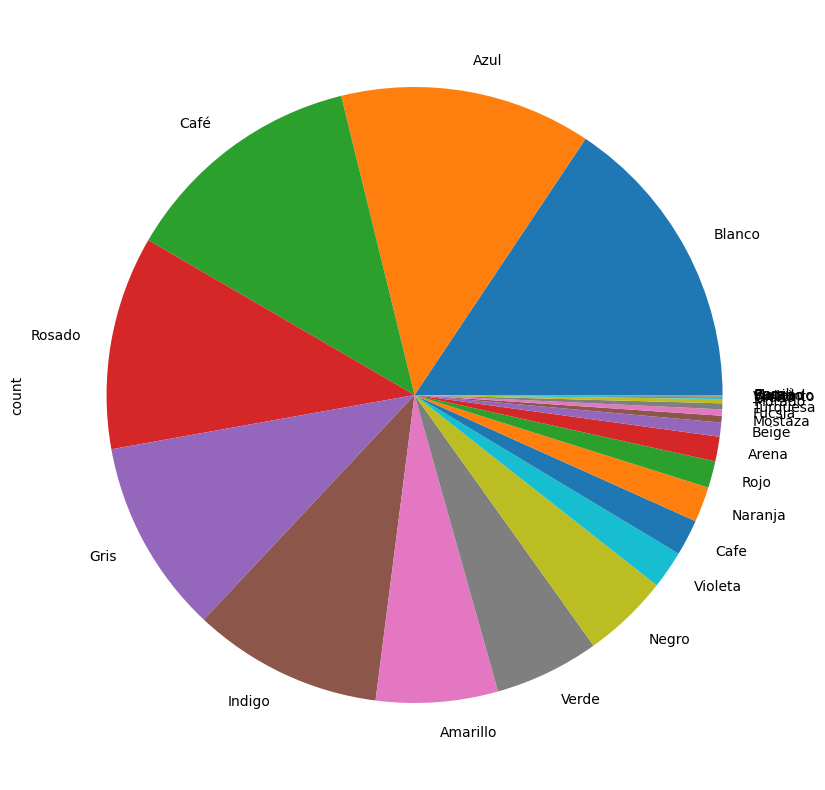

In [188]:
df['AFS: COLOR'].str.extract(r'(.+?)\s')[0].value_counts().plot(kind='pie', figsize=(10,10), style='ggplot')

In [186]:
df['AFS: COLOR'].str.extract(r'(.+?)\s')[0]

0              Rojo
1              Rojo
2              Rojo
3              Rojo
4              Rojo
5              Rojo
6              Rojo
7              Rojo
8              Rojo
9              Rojo
10             Rojo
11             Rojo
12             Rojo
13             Rojo
14             Rojo
15             Rojo
16             Rojo
17             Rojo
18             Rojo
19             Rojo
20             Rojo
21             Rojo
22             Rojo
23             Rojo
24             Rojo
25             Rojo
26             Rojo
27             Rojo
28             Rojo
29             Rojo
30             Rojo
31             Rojo
32             Rojo
33             Rojo
34             Rojo
35             Rojo
36             Rojo
37             Rojo
38             Rojo
39             Rojo
40             Rojo
41             Rojo
42             Rojo
43             Rojo
44             Rojo
45             Rojo
46             Rojo
47             Rojo
48             Rojo
49             Rojo


In [181]:
colores = df['AFS: COLOR'].str.extract(r'(.+?)\s')[0].unique()
colores

array(['Rojo', 'Plateado', 'Turquesa', 'Verde', 'Amarillo', 'Coral',
       'Arena', 'Mostaza', 'Rosado', 'Vinotinto', nan, 'Surtido', 'Azul',
       'Fucsia', 'Rosa', 'Café', 'Caqui', 'Gris', 'Beige', 'Blanco',
       'Negro', 'Naranja', 'Indigo', 'Violeta', 'Morado', 'Cafe', 'Crudo'],
      dtype=object)

In [189]:
df.columns

Index(['# Factura', '# Pedido', 'Clase Fact.', 'D. Clase Fact.', 'Sociedad',
       'CeBe', 'Nombre Sociedad', 'Descripcion Sociedad', 'Ciudad',
       'C. Org. Vtas', 'Sociedad-Canal', 'Organización Ventas',
       'Oficina de ventas', 'Canal', 'C. Canal', 'Codigo Centro', 'F. Factura',
       'H. Factura', 'AÑO', 'MES', 'Unidad', 'MATERIAL', 'Descrip. Material',
       'AFS: TALLA', 'AFS: COLOR', 'UNIDADES', 'MONEDA', 'Vlr. Bruto',
       'Vlr. Desc.', 'Vlr. Neto', 'Vlr. Iva', 'Vlr. Total', 'Costo',
       'Costo Hermeco', 'Pais', 'Marca', 'Tipo de Negocio', 'Destino',
       'Año de Venta', 'Mes de Venta', 'Edad', 'Género', 'Sublínea',
       'Grupo de Artículo', 'Tipo de Artículo', 'Tipo de Tejido',
       'Tipo de Referencia', 'País de Orígen', 'Saldo', 'Clase', 'Mundo',
       'Concepto Diseño', 'Colección', 'SOLICITANTE', 'País', 'REGIÓN',
       'CANAL', 'SEMANA', 'VALOR VENTA POS', 'COSTO', 'FECHA VENTA'],
      dtype='object')

In [208]:
df['Tipo de Artículo'].unique()

array(['BUZO', 'VESTIDO MANGA SISA', 'BALACA', 'BALETA', 'OTROS',
       'SANDALIA', 'TENIS', 'ZAPATOS COSIDOS', 'CAMISETA MANGA CORTA',
       'CAMISA MANGA CORTA', 'BIKINI', 'SALIDA DE BAÑO',
       'VESTIDO MANGA LARGA', 'CAMISETA MANGA SISA', 'PANTALONETA',
       'CAMISETA POLO', 'ESMALTE', 'BOXER', 'SABANA RESORTADA', 'SET',
       'SHORT', 'PANTALON', 'BODY MANGA CORTA', 'CONJUNTO LARGO',
       'BABITAS', 'BERMUDA', 'FULAR', 'CONJUNTO CORTO', 'GORRO',
       'LEGGINGS', 'PAÑALERA', 'VESTIDO ENTERO', 'CAMISETA MANGA LARGA',
       'CAMISA MANGA SISA', 'TOALLA', 'SUDADERA', 'JUEGO SABANAS SENC',
       'CHAQUETA', 'ENTERIZO CORTO', 'VESTIDO MANGA CORTA', 'BABERO',
       'PIJAMA ENTERIZO', 'BODY MANGA SISA', 'OVERALL LARGO',
       'ENTERIZO LARGO', 'OVERALL CORTO', 'CAÑA CORTA',
       'ZAPATOS PRECAMINADOR', 'CORREA', 'BOTAS', 'PIJAMA MS-PC',
       'TANKINI', 'SWEATER', 'BODY', 'MEDIAS', 'CUIDADO PERSONAL',
       'PANTUFLAS', 'PIJAMA ML-PL', 'GAFAS', 'TOP CORTO', 'BODY POLO',

In [ ]:
FECHA VENTA	AFS: COLOR	Año de Venta	Mes de Venta	Edad	Género	Grupo de Artículo	Tipo de Artículo	Tipo de Tejido	Mundo	REGIÓN


In [226]:
sum(df['FECHA VENTA']!=df['F. Factura'])

0

In [228]:
len(df['Tipo de Artículo'].unique())

127

In [221]:
len(df['REGIÓN'].unique())

33

In [212]:
grupos_tipos = df[['Grupo de Artículo', 'Tipo de Artículo']]

In [214]:
grupos_tipos.head()

,Grupo de Artículo,Tipo de Artículo
0,BUZO O CHAQUETA,BUZO
1,VESTIDO,VESTIDO MANGA SISA
2,VESTIDO,VESTIDO MANGA SISA
3,VESTIDO,VESTIDO MANGA SISA
4,VESTIDO,VESTIDO MANGA SISA


In [203]:
len(df['Tipo de Tejido'].unique())

4

In [184]:
df['AFS: COLOR'].str.extract(r'(.+?)\s')[0].value_counts()

0
Blanco       48764
Azul         41150
Café         39879
Rosado       34939
Gris         31785
Indigo       31081
Amarillo     19934
Verde        17162
Negro        14119
Violeta       6196
Cafe          5914
Naranja       5795
Rojo          4360
Arena         4034
Beige         2310
Mostaza       1100
Fucsia        1032
Turquesa       969
Morado         701
Crudo          279
Vinotinto      128
Plateado       124
Surtido         50
Coral           39
Caqui           17
Rosa            12
Name: count, dtype: int64

In [148]:
df.describe()

,AÑO,MES,UNIDADES,Vlr. Bruto,Vlr. Desc.,Vlr. Neto,Vlr. Iva,Vlr. Total,Costo,Costo Hermeco,SEMANA,VALOR VENTA POS,COSTO,FECHA VENTA,AÑO,MES,UNIDADES,Vlr. Bruto,Vlr. Desc.,Vlr. Neto,Vlr. Iva,Vlr. Total,Costo,Costo Hermeco,SEMANA,VALOR VENTA POS,COSTO,FECHA VENTA
count,311925.0,311925.000000,311925.0,311925.000000,311925.000000,311925.000000,311925.000000,311925.000000,311925.000000,311855.000000,311925.000000,311925.000000,311857.000000,311925,311925.0,311925.000000,311925.0,311925.000000,311925.000000,311925.000000,311925.000000,311925.000000,311925.000000,311855.000000,311925.000000,311925.000000,311857.000000,311925
mean,2023.0,2.687184,1.0,73867.020168,-4370.603825,69496.418889,12957.309757,82453.722937,33774.152658,26620.557589,10.679942,69496.418889,26674.478113,2023-03-07 05:56:34.681414144,2023.0,2.687184,1.0,73867.020168,-4370.603825,69496.418889,12957.309757,82453.722937,33774.152658,26620.557589,10.679942,69496.418889,26674.478113,2023-03-07 05:56:34.681414144
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
max,2023.0,5.000000,1.0,204800.000000,0.000000,204800.000000,35924.000000,224990.000000,120680.000000,89671.000000,19.000000,204800.000000,89744.000000,2023-05-02 00:00:00,2023.0,5.000000,1.0,204800.000000,0.000000,204800.000000,35924.000000,224990.000000,120680.000000,89671.000000,19.000000,204800.000000,89744.000000,2023-05-02 00:00:00
std,0.0,1.174476,0.0,34368.690382,9348.551357,34123.055099,6684.896725,40568.200277,18920.789852,13958.847963,5.103751,34123.055099,13975.110455,NaN,0.0,1.174476,0.0,34368.690382,9348.551357,34123.055099,6684.896725,40568.200277,18920.789852,13958.847963,5.103751,34123.055099,13975.110455,NaN


In [147]:
df.info

<bound method DataFrame.info of           # Pedido Clase Fact.        D. Clase Fact. Sociedad      CeBe  \
0       1011583505        ZPOS  Factura POS Bol Vtas     2000  CB130117   
1       1011673193        ZPOS  Factura POS Bol Vtas     2000    CB7101   
...            ...         ...                   ...      ...       ...   
312412  1011545469        ZPOS  Factura POS Bol Vtas     2000  CB130117   
312413  1011506025        ZPOS  Factura POS Bol Vtas     2000  CB130117   

        Nombre Sociedad     Descripcion Sociedad           Ciudad  \
0          MAREDU S.A.S  FRANQUICIAS COLOMBIANAS     DOSQUEBRADAS   
1       FRANQUICIAS POS  FRANQUICIAS COLOMBIANAS  BARRANCABERMEJA   
...                 ...                      ...              ...   
312412     MAREDU S.A.S  FRANQUICIAS COLOMBIANAS     DOSQUEBRADAS   
312413     MAREDU S.A.S  FRANQUICIAS COLOMBIANAS     DOSQUEBRADAS   

       C. Org. Vtas Sociedad-Canal Organización Ventas     Oficina de ventas  \
0              2130   

In [127]:
for col in df.columns:
    if df[col].dtype:
        if df[col].dtype == 'object':
            # Creación de variables dummy para columnas con valores categóricos
            dummy_cols = pd.get_dummies(df, columns=[col], sparse=True)
            # dummy_cols = pd.get_dummies(df[col], prefix=col)
            df = pd.concat([df, dummy_cols], axis=1)
            # Eliminación de la columna original
            df.drop(columns=[col], inplace=True)

AttributeError: 'DataFrame' object has no attribute 'dtype'

In [117]:
all2023.corr()

ValueError: could not convert string to float: 'ZPOS'

In [92]:
print(all2023.isna().sum())

# Factura                0
# Pedido                 0
Clase Fact.              0
D. Clase Fact.           0
Sociedad                 0
CeBe                     0
Nombre Sociedad          0
Descripcion Sociedad     0
Ciudad                   0
C. Org. Vtas             0
Sociedad-Canal           0
Organización Ventas      0
Oficina de ventas        0
Canal                    0
C. Canal                 0
Codigo Centro            0
F. Factura               0
H. Factura               0
AÑO                      0
MES                      0
Unidad                   0
MATERIAL                 0
Descrip. Material        0
AFS: TALLA               0
AFS: COLOR               0
UNIDADES                 0
MONEDA                   0
Vlr. Bruto               0
Vlr. Desc.               0
Vlr. Neto                0
Vlr. Iva                 0
Vlr. Total               0
Costo                    0
Costo Hermeco           70
Pais                     0
Marca                    0
Tipo de Negocio          0
D

In [91]:
head_tail(all2023, 3)

,# Factura,# Pedido,Clase Fact.,D. Clase Fact.,Sociedad,CeBe,Nombre Sociedad,Descripcion Sociedad,Ciudad,C. Org. Vtas,...,Concepto Diseño,Colección,SOLICITANTE,País,REGIÓN,CANAL,SEMANA,VALOR VENTA POS,COSTO,FECHA VENTA
0,0670921838,1011583505,ZPOS,Factura POS Bol Vtas,2000,CB130117,MAREDU S.A.S,FRANQUICIAS COLOMBIANAS,DOSQUEBRADAS,2130,...,APROVECHAMIENTO,10900,,CO,RISARALDA,FRANQUICIAS,12,48398.0,27941.0,2023-03-19
1,0379576328,1011673193,ZPOS,Factura POS Bol Vtas,2000,CB7101,FRANQUICIAS POS,FRANQUICIAS COLOMBIANAS,BARRANCABERMEJA,2010,...,SPECIAL OCCASIONS,11209,,CO,SANTANDER,FRANQUICIAS,18,117639.0,41320.0,2023-04-28
2,0686330658,1011675642,ZPOS,Factura POS Bol Vtas,2000,CB7101,FRANQUICIAS POS,FRANQUICIAS COLOMBIANAS,PEREIRA,2130,...,SPECIAL OCCASIONS,11209,,CO,RISARALDA,FRANQUICIAS,18,117639.0,41320.0,2023-04-29
312411,0374761098,1011556937,ZPOS,Factura POS Bol Vtas,2000,CB130126,OUTLET PLAZUELA 23,FRANQUICIAS COLOMBIANAS,SANTA MARTA,2010,...,APROVECHAMIENTO,CLASICA,,CO,MAGDALENA,FRANQUICIAS,11,33272.0,21991.0,2023-03-08
312412,0670921281,1011545469,ZPOS,Factura POS Bol Vtas,2000,CB130117,MAREDU S.A.S,FRANQUICIAS COLOMBIANAS,DOSQUEBRADAS,2130,...,APROVECHAMIENTO,CLASICA,,CO,VALLE,FRANQUICIAS,10,33272.0,21991.0,2023-03-03
312413,0670920797,1011506025,ZPOS,Factura POS Bol Vtas,2000,CB130117,MAREDU S.A.S,FRANQUICIAS COLOMBIANAS,DOSQUEBRADAS,2130,...,APROVECHAMIENTO,CLASICA,,CO,RISARALDA,FRANQUICIAS,7,33272.0,21991.0,2023-02-09


In [69]:
all2023['Edad'].unique()

array(['NIÑOS', 'PRIMI', 'MASCOTAS', 'BEBES', 'OTROS'], dtype=object)

"rm" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.


In [18]:
conn = db.connect(address='10.0.0.110', port='30015', user='DESARROLLO', password='DevHermeco.2022')
cursor = conn.cursor()
sql = '''SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2023'''

all2023 = pd.read_sql_query(sql, conn)

In [19]:
len(all2023)

312414

In [15]:
len(five_rows)

1000

* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 LIMIT 1 ``` 1min 31 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2022 LIMIT 1 ``` 7.7 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2022 LIMIT 5 ```  9 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2022 LIMIT 20 ``` 9 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2021 LIMIT 20 ``` 14.3 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2023 LIMIT 50 ``` 5.6 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2023 LIMIT 1000 ``` 6.1 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2023 LIMIT 9000 ``` 6.9 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2022 LIMIT 9000 ``` 11.1 s
* ```SELECT * FROM HEP300.VW_CD_REPORTE_VENTAS_ALL_2016 WHERE(CANAL = 'FRANQUICIAS' OR CANAL = 'TIENDAS PROPIAS') AND "AÑO" >= 2023``` 1 min 8.9 s (312414 regs)

In [25]:
len(all2023)

312414

In [65]:
(all2023[all2023['Marca']=='ALETA']).shape

(489, 61)

In [45]:
all2023['Marca'].unique()

array(['OFFCORSS', 'ALETA'], dtype=object)

In [52]:
print(len(all2023))
for column in all2023.columns:
    print(len(all2023[column].unique()),'\t\t\t',column)

312414
151068 			 # Factura
151067 			 # Pedido
3 			 Clase Fact.
3 			 D. Clase Fact.
2 			 Sociedad
58 			 CeBe
58 			 Nombre Sociedad
2 			 Descripcion Sociedad
44 			 Ciudad
10 			 C. Org. Vtas
12 			 Sociedad-Canal
10 			 Organización Ventas
88 			 Oficina de ventas
3 			 Canal
3 			 C. Canal
88 			 Codigo Centro
122 			 F. Factura
37329 			 H. Factura
1 			 AÑO
5 			 MES
1 			 Unidad
2739 			 MATERIAL
2017 			 Descrip. Material
74 			 AFS: TALLA
488 			 AFS: COLOR
1 			 UNIDADES
1 			 MONEDA
300 			 Vlr. Bruto
1163 			 Vlr. Desc.
1407 			 Vlr. Neto
1894 			 Vlr. Iva
2066 			 Vlr. Total
24650 			 Costo
2612 			 Costo Hermeco
1 			 Pais
2 			 Marca
2 			 Tipo de Negocio
8 			 Destino
9 			 Año de Venta
12 			 Mes de Venta
5 			 Edad
4 			 Género
16 			 Sublínea
30 			 Grupo de Artículo
127 			 Tipo de Artículo
4 			 Tipo de Tejido
4 			 Tipo de Referencia
8 			 País de Orígen
2 			 Saldo
9 			 Clase
8 			 Mundo
62 			 Concepto Diseño
621 			 Colección
1 			 SOLICITANTE
1 			 País
3

In [28]:
print(len(all2023['# Factura'].unique()))
len(all2023['# Pedido'].unique())

151068


151067

In [7]:
one_row2

,# Factura,# Pedido,Clase Fact.,D. Clase Fact.,Sociedad,CeBe,Nombre Sociedad,Descripcion Sociedad,Ciudad,C. Org. Vtas,...,Concepto Diseño,Colección,SOLICITANTE,País,REGIÓN,CANAL,SEMANA,VALOR VENTA POS,COSTO,FECHA VENTA
0,0021834538,0065744513,ZFNA,Factura Nacional,1000,CB1801,TIENDA VIRTUAL,C.I. HERMECO S.A.,MEDELLIN,1030,...,SUNSHINE FESTIVAL,8079,,CO,TOLIMA,TIENDA VIRTUAL,39,0.0,18769.0,2018-09-30


In [37]:
five_rows[:10].to_excel('example.xlsx')

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9236134 entries, 0 to 9236133
Data columns (total 14 columns):
 #   Column            Dtype  
---  ------            -----  
 0   AÑO               int64  
 1   CANAL             object 
 2   MES               int64  
 3   MATERIAL          object 
 4   AFS: COLOR        object 
 5   AFS: TALLA        object 
 6   UNIDADES          float64
 7   Sublínea          object 
 8   Mundo             object 
 9   Tipo de Artículo  object 
 10  Concepto Diseño   object 
 11  Año de Venta      object 
 12  Mes de Venta      object 
 13  FECHA VENTA       object 
dtypes: float64(1), int64(2), object(11)
memory usage: 986.5+ MB


#### Testing Parket and Feather
[9236134 rows x 14 columns] dtypes: float64(1), int64(2), object(11)
memory usage: 986.5+ MB

* Parquet
    * Writing Time: ~1 min 30 s
    * Writing Time: ~5.1 s
    * File size: ~19.2 MB
* Feather
    * Writing Time: ~22 s
    * Writing Time: ~3.8 s
    * File size: ~414 MB


In [10]:
pd.read_parquet('2018_2023_05_02.parquet')

,AÑO,CANAL,MES,MATERIAL,AFS: COLOR,AFS: TALLA,UNIDADES,Sublínea,Mundo,Tipo de Artículo,Concepto Diseño,Año de Venta,Mes de Venta,FECHA VENTA
0,2019,FRANQUICIAS,11,3111529,Verde 12-0435,12,1.0,BASICOS,PRIMI NIÑO,BODY MANGA CORTA,BASICOS,2018,FEBRERO,2019-11-17
1,2019,FRANQUICIAS,11,3111529,Verde 12-0435,12,1.0,BASICOS,PRIMI NIÑO,BODY MANGA CORTA,BASICOS,2018,FEBRERO,2019-11-02
2,2019,FRANQUICIAS,11,3111529,Verde 12-0435,18,1.0,BASICOS,PRIMI NIÑO,BODY MANGA CORTA,BASICOS,2018,FEBRERO,2019-11-17
3,2019,FRANQUICIAS,8,3111529,Verde 12-0435,18,1.0,BASICOS,PRIMI NIÑO,BODY MANGA CORTA,BASICOS,2018,FEBRERO,2019-08-23
4,2018,TIENDAS PROPIAS,1,5105683,Verde 12-0435,6,1.0,MODA,NIÑO,PANTALONETA,REFERENCIAS EVACUADORAS,2017,DICIEMBRE,2018-01-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9236129,2023,TIENDAS PROPIAS,4,4136124,Indigo Oscuro,6,1.0,BASICOS,BEBÉ NIÑO,DENIM,BASICOS,2023,ABRIL,2023-04-30
9236130,2023,FRANQUICIAS,4,4136124,Indigo Oscuro,6,1.0,BASICOS,BEBÉ NIÑO,DENIM,BASICOS,2023,ABRIL,2023-04-30
9236131,2023,TIENDAS PROPIAS,5,4136124,Indigo Oscuro,6,1.0,BASICOS,BEBÉ NIÑO,DENIM,BASICOS,2023,ABRIL,2023-05-01
9236132,2023,TIENDAS PROPIAS,5,4136124,Indigo Oscuro,6,1.0,BASICOS,BEBÉ NIÑO,DENIM,BASICOS,2023,ABRIL,2023-05-01


In [55]:
df =pd.read_feather('2018_2023_05_02.feather')

In [56]:
df

,AÑO,CANAL,MES,MATERIAL,AFS: COLOR,AFS: TALLA,UNIDADES,Sublínea,Mundo,Tipo de Artículo,Concepto Diseño,Año de Venta,Mes de Venta,FECHA VENTA
0,2019,FRANQUICIAS,11,3111529,Verde 12-0435,12,1.0,BASICOS,PRIMI NIÑO,BODY MANGA CORTA,BASICOS,2018,FEBRERO,2019-11-17
1,2019,FRANQUICIAS,11,3111529,Verde 12-0435,12,1.0,BASICOS,PRIMI NIÑO,BODY MANGA CORTA,BASICOS,2018,FEBRERO,2019-11-02
2,2019,FRANQUICIAS,11,3111529,Verde 12-0435,18,1.0,BASICOS,PRIMI NIÑO,BODY MANGA CORTA,BASICOS,2018,FEBRERO,2019-11-17
3,2019,FRANQUICIAS,8,3111529,Verde 12-0435,18,1.0,BASICOS,PRIMI NIÑO,BODY MANGA CORTA,BASICOS,2018,FEBRERO,2019-08-23
4,2018,TIENDAS PROPIAS,1,5105683,Verde 12-0435,6,1.0,MODA,NIÑO,PANTALONETA,REFERENCIAS EVACUADORAS,2017,DICIEMBRE,2018-01-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9236129,2023,TIENDAS PROPIAS,4,4136124,Indigo Oscuro,6,1.0,BASICOS,BEBÉ NIÑO,DENIM,BASICOS,2023,ABRIL,2023-04-30
9236130,2023,FRANQUICIAS,4,4136124,Indigo Oscuro,6,1.0,BASICOS,BEBÉ NIÑO,DENIM,BASICOS,2023,ABRIL,2023-04-30
9236131,2023,TIENDAS PROPIAS,5,4136124,Indigo Oscuro,6,1.0,BASICOS,BEBÉ NIÑO,DENIM,BASICOS,2023,ABRIL,2023-05-01
9236132,2023,TIENDAS PROPIAS,5,4136124,Indigo Oscuro,6,1.0,BASICOS,BEBÉ NIÑO,DENIM,BASICOS,2023,ABRIL,2023-05-01


In [8]:
df.columns

Index(['AÑO', 'CANAL', 'MES', 'MATERIAL', 'AFS: COLOR', 'AFS: TALLA',
       'UNIDADES', 'Sublínea', 'Mundo', 'Tipo de Artículo', 'Concepto Diseño',
       'Año de Venta', 'Mes de Venta', 'FECHA VENTA'],
      dtype='object')

In [7]:
df['AÑO'].unique()

array([2019, 2018, 2020, 2021, 2022, 2023], dtype=int64)

In [5]:
def XGB_model(df_model):
    # Fechas forecast
    fecha_inicial = '2023-03'
    fecha_final = '2024-02'
    
    df_model.MES_AÑO = pd.to_datetime(df_model.MES_AÑO)
    
    #  TRAIN & TEST
    train = df_model.loc[df_model.MES_AÑO < pd.to_datetime(fecha_inicial)].set_index('MES_AÑO')

    test = df_model.loc[(df_model.MES_AÑO >= pd.to_datetime(fecha_inicial)) & 
                        (df_model.MES_AÑO < pd.to_datetime(fecha_final))].set_index('MES_AÑO')


    # Define el train y test de acuerdo con las bases de datos de train y de test
    X_train, y_train = create_features_mes_venta(train, label = 'UNIDADES')
    X_test, y_test = create_features_mes_venta(test, label = 'UNIDADES')

    reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                           n_estimators = 1000,
                           early_stopping_rounds=50,
                           objective='reg:squarederror',
                           max_depth=3,
                           learning_rate=0.01,
                           eval_metric = ['rmse','mae','mape']
                           )
    
    reg.fit(X_train,y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        verbose = False)

    pred_test = reg.predict(X_test)
    test['UNIDADES'] = np.ceil(pred_test)

    
    return test[['UNIDADES']]

In [6]:
def xgb_mes_a_mes(basicos1):
    meses_basicos = [1,2,3,4,5,6,7,8,9,10,11,12]
    basicos_forecast = {}

    basicos_results = pd.DataFrame()
    basicos1['MES'] = pd.to_datetime(basicos1['MES_AÑO']).dt.month

    for mes in meses_basicos:
        if mes in basicos1['MES'].unique():
            basicos_results = pd.concat([basicos_results, XGB_model(basicos1[basicos1['MES'] == mes])])
            
        else:
            basicos_forecast[mes] = 0

    return basicos_results

In [7]:
def calcular_Cv(basicos1):
    basicos_clasificacion = pd.DataFrame()
    meses = basicos1.MES.unique()
    # meses = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

    # Calcular el factor CV para cada mes
    cv_mes = {}
    for mes in meses:
        if mes in basicos1['MES'].unique():
            cv_mes[mes] = round(basicos1[basicos1['MES'] == mes]['UNIDADES'].std()
                                / basicos1[basicos1['MES'] == mes]['UNIDADES'].mean(), 2)
        # else:
        #     cv_mes[mes] = 0


    lista_cv = []
    for i in cv_mes.values():
        lista_cv.append(i)
    
    coeficiente_Var = np.std(lista_cv)/np.mean(lista_cv)

    return round(coeficiente_Var,2)


In [8]:
basicos = df_canal[df_canal['Concepto Diseño']== 'BASICOS']

### Ejemplo

In [9]:
basicos_individual = basicos[(basicos['Mundo'] == 'NIÑA' ) &
                                        (basicos['Tipo de Artículo'] == 'CAMISA MANGA LARGA')]

basicos_individual.head(2)

,AÑO,CANAL,MES,MATERIAL,AFS: COLOR,AFS: TALLA,UNIDADES,Sublínea,Mundo,Tipo de Artículo,Concepto Diseño,Año de Venta,Mes de Venta,FECHA VENTA
451838,2018,TIENDAS PROPIAS,7,5204453,Rosado 12-1310,10,1.0,BASICOS,NIÑA,CAMISA MANGA LARGA,BASICOS,2018,FEBRERO,2018-07-14
451839,2018,TIENDAS PROPIAS,5,5204453,Rosado 12-1310,10,1.0,BASICOS,NIÑA,CAMISA MANGA LARGA,BASICOS,2018,FEBRERO,2018-05-24


#### MODELO LINEAL

In [10]:
basicos_individual['FECHA'] = pd.to_datetime(basicos_individual['FECHA VENTA']).dt.to_period('M')

In [11]:
# HISTORICO
df_model = basicos_individual.groupby('FECHA')['UNIDADES'].sum().reset_index()

In [12]:
# convert period to timestamp
df_model['FECHA'] = df_model['FECHA'].apply(lambda x: x.to_timestamp())
# assign covid column
df_model['covid'] = [1 if ((x > pd.Timestamp('2020-03')) & (x < pd.Timestamp('2021-03'))) else 0 for x in df_model.FECHA]


In [13]:
df_model['month'] = df_model['FECHA'].dt.month
df_model['year'] = df_model['FECHA'].dt.year


# Define the features and target variable
X = df_model.drop(['UNIDADES','FECHA'], axis=1)
y = df_model['UNIDADES']

In [14]:
#  Split the data into training and testing sets
split_Date_test = '2022-11-01'

train_size = df_model.loc[df_model['FECHA'] >= split_Date_test].index[0]
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

In [15]:
tuned_parameters = {
        'max_depth': [3, 6, 10],
        'learning_rate': [0.01, 0.05, 0.1],
        'n_estimators': [100, 500, 1000],
        'base_score': [0.1, 0.3, 0.5],
        'eval_metric': ['rmse', 'mae', 'mape']
    }
# xgbr = XGBRegressor(learning_rate=0.3, max_depth=6, n_estimators=100,subsample=0.8)
# clf = GridSearchCV(xgbr, param_grid = tuned_parameters, cv = 5)
# clf.fit(X_train, y_train)

In [16]:
xg_reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                        n_estimators = 1000,
                        objective='reg:squarederror',
                        max_depth=3,
                        learning_rate=0.01,
                        eval_metric = ['rmse','mae','mape']
                        )

# Fit the model to the training data
xg_reg.fit(X_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=['rmse', 'mae', 'mape'], feature_types=None, gamma=0,
             gpu_id=-1, grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.01, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=3, max_leaves=0, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, ...)

In [17]:
test = df_model.loc[df_model['FECHA'] >= split_Date_test]
test['forecast'] = np.ceil(xg_reg.predict(X_test))

In [18]:
y_test = test['UNIDADES'][:5]
pred_test = test['forecast'][:5]

print("R^2      ..............",   round( r2_score(y_test, pred_test),1))
print('MAPE ES  ..............',   round(MAPE(y_test, pred_test),2))
test

R^2      .............. 0.4
MAPE ES  .............. 1.5


,FECHA,UNIDADES,covid,month,year,forecast
57,2022-11-01,134.0,0,11,2022,108.0
58,2022-12-01,350.0,0,12,2022,128.0
59,2023-01-01,13.0,0,1,2023,15.0
60,2023-02-01,3.0,0,2,2023,13.0
61,2023-03-01,5.0,0,3,2023,21.0
62,2023-04-01,2.0,0,4,2023,52.0


<AxesSubplot: xlabel='FECHA'>

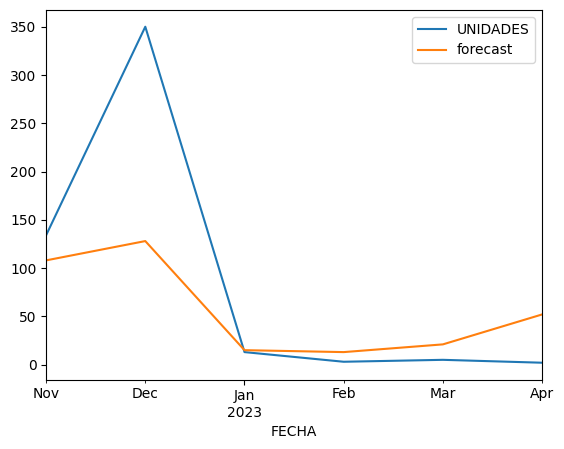

In [19]:
test.set_index('FECHA')[['UNIDADES', 'forecast']].plot()



#### MODELO MENSUAL 2022


In [20]:
# la funcion recibe todas las columnas de DF como caracteristicas y elimina el target

def create_features_mes_venta(df, label=None):

    X = df.drop(columns=[label],axis=1)

    if label:
        y = df[label]

        return X, y
        
    return X

In [21]:
# MODELO PARA METRICAS
# DF_MODEL_MONTH DEBE INCLUIR LAS SIGUIENTES COLUMNAS
# MONTH, YEAR, COVID
def XGB_model_2022(df_model_month, initial_Date=None):

    # initial_Date = '2022-11-01'

    # df_model_month = df_model_month.set_index('FECHA')
    limit_month = '2022-06-01'

    train_month = df_model_month.loc[df_model_month['FECHA'] < limit_month].set_index('FECHA')#.drop(columns={'FECHA'},axis=1)
    test_month = df_model_month.loc[df_model_month['FECHA'] >= limit_month].set_index('FECHA')#.drop(columns={'FECHA'},axis=1)

    X_train, y_train = create_features_mes_venta(train_month, label = 'UNIDADES')
    X_test, y_test = create_features_mes_venta(test_month, label = 'UNIDADES')

    xg_reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                        n_estimators = 1000,
                        objective='reg:squarederror',
                        max_depth=3,
                        learning_rate=0.01,
                        eval_metric = ['rmse','mae','mape']
                        )

    # Fit the model to the training data
    xg_reg.fit(X_train,y_train)

    test_month['forecast'] = np.ceil(xg_reg.predict(X_test))

    return  test_month


In [22]:
meses_basicos = [1,2,3,4,5,6,7,8,9,10,11,12]
basicos_forecast = {}

basicos_results = pd.DataFrame()

for mes in meses_basicos:
    if mes in df_model['month'].unique():
        df_model2 = df_model.loc[df_model['month'] == mes]
        basicos_results = pd.concat([basicos_results,XGB_model_2022(df_model[df_model['month'] == mes])])


In [23]:
basicos_results

,UNIDADES,covid,month,year,forecast
FECHA,,,,,
2023-01-01,13.0,0,1,2023,2.0
2023-02-01,3.0,0,2,2023,4.0
2023-03-01,5.0,0,3,2023,3.0
2023-04-01,2.0,0,4,2023,50.0
2022-06-01,107.0,0,6,2022,54.0
2022-07-01,102.0,0,7,2022,62.0
2022-08-01,79.0,0,8,2022,44.0
2022-09-01,59.0,0,9,2022,66.0
2022-10-01,81.0,0,10,2022,56.0


In [24]:
basicos_results.sort_index()
y_test = basicos_results['UNIDADES']
pred_test = basicos_results['forecast']

print("R^2      ..............",   round( r2_score(y_test, pred_test),1))
print('MAPE ES  ..............',   round(MAPE(y_test, pred_test),2))
basicos_results.sort_index()

R^2      .............. 0.5
MAPE ES  .............. 2.57


,UNIDADES,covid,month,year,forecast
FECHA,,,,,
2022-06-01,107.0,0,6,2022,54.0
2022-07-01,102.0,0,7,2022,62.0
2022-08-01,79.0,0,8,2022,44.0
2022-09-01,59.0,0,9,2022,66.0
2022-10-01,81.0,0,10,2022,56.0
2022-11-01,134.0,0,11,2022,92.0
2022-12-01,350.0,0,12,2022,142.0
2023-01-01,13.0,0,1,2023,2.0
2023-02-01,3.0,0,2,2023,4.0


<AxesSubplot: xlabel='FECHA'>

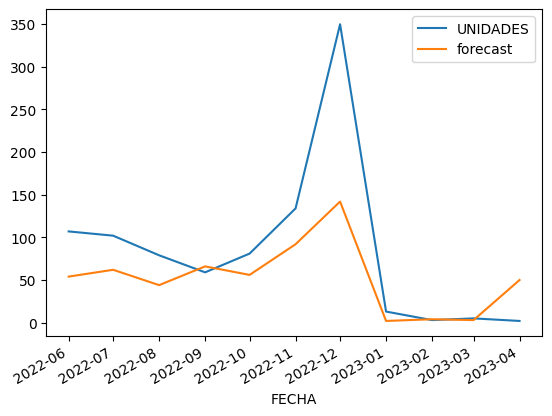

In [25]:
basicos_results[['UNIDADES','forecast']].plot()

In [26]:
df_model_month = df_model.loc[df_model['month'] == 4]
df_model_month

,FECHA,UNIDADES,covid,month,year
3,2018-04-01,389.0,0,4,2018
15,2019-04-01,196.0,0,4,2019
38,2021-04-01,66.0,0,4,2021
50,2022-04-01,50.0,0,4,2022
62,2023-04-01,2.0,0,4,2023


In [27]:
limit_month = '2023-04-01'

In [28]:
train_month = df_model_month.loc[df_model_month['FECHA'] < limit_month].drop(columns={'FECHA'},axis=1)
test_month = df_model_month.loc[df_model_month['FECHA'] >= limit_month].drop(columns={'FECHA'},axis=1)

In [29]:
X_train, y_train = create_features_mes_venta(train_month, label = 'UNIDADES')
X_test, y_test = create_features_mes_venta(test_month, label = 'UNIDADES')

In [30]:
xg_reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                        n_estimators = 1000,
                        objective='reg:squarederror',
                        max_depth=3,
                        learning_rate=0.01,
                        eval_metric = ['rmse','mae','mape']
                        )

# Fit the model to the training data
xg_reg.fit(X_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=['rmse', 'mae', 'mape'], feature_types=None, gamma=0,
             gpu_id=-1, grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.01, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=3, max_leaves=0, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, ...)

In [31]:
test_month['forecast'] = np.ceil(xg_reg.predict(X_test))

In [32]:
test_month

,UNIDADES,covid,month,year,forecast
62,2.0,0,4,2023,50.0


#### MODELO DEL FUTURO MES A MES

In [33]:
df_model = df_model.loc[df_model['FECHA'] <= '2023-03-01']

In [34]:
df_model.head()

,FECHA,UNIDADES,covid,month,year
0,2018-01-01,337.0,0,1,2018
1,2018-02-01,229.0,0,2,2018
2,2018-03-01,334.0,0,3,2018
3,2018-04-01,389.0,0,4,2018
4,2018-05-01,412.0,0,5,2018


In [35]:
# MODELO PARA PRONOSTICO FUTURO
# MODELO LINEAL
# DF_MODEL_MONTH DEBE INCLUIR LAS SIGUIENTES COLUMNAS
# UNIDADES, COVID, MONTH, YEAR -- EN ESE ORDEN SIEMPRE 

def XGB_model_future(df_model_month, initial_Date=None):

    new_dates = pd.date_range(start = '2023-04-01', end='2023-10-01', freq='MS')
    new_df = pd.DataFrame({'UNIDADES':0,'covid':0,'month': new_dates.month, 'year': new_dates.year}, index=new_dates)
    new_df.index.name = 'FECHA'

    new_X = new_df.drop(['UNIDADES'], axis=1)

    limit_month = '2023-04-01'
    train_month = df_model_month.loc[df_model_month['FECHA'] < limit_month].set_index('FECHA')#.drop(columns={'FECHA'},axis=1)
    
    X_train, y_train = create_features_mes_venta(train_month, label = 'UNIDADES')

    xg_reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                        n_estimators = 1000,
                        objective='reg:squarederror',
                        max_depth=3,
                        learning_rate=0.01,
                        eval_metric = ['rmse','mae','mape']
                        )

    # Fit the model to the training data
    xg_reg.fit(X_train,y_train)

    # test_month['forecast'] = np.ceil(xg_reg.predict(X_test))
    new_df['predicted_sales'] = np.ceil(xg_reg.predict(new_X))

    return  new_df

In [36]:
# GENERA UN SOLO RESULTADO PERO SE TOMA TODO EL HISTORICO 
# PORQUE SI TOMAMOS TODOS LOS MESES ENTONCES SE REPLICA EL ULTIMO VALOR

def XGB_model_future_monthly(df_model_month, date_test):

    new_dates = pd.date_range(start = date_test, end=date_test, freq='MS')
    new_df = pd.DataFrame({'UNIDADES':0,'covid':0,'month': new_dates.month, 'year': new_dates.year}, index=new_dates)
    new_df.index.name = 'FECHA'

    new_X = new_df.drop(['UNIDADES'], axis=1)

    limit_month = '2023-04-01'
    train_month = df_model_month.loc[df_model_month['FECHA'] < limit_month].set_index('FECHA')#.drop(columns={'FECHA'},axis=1)
    
    X_train, y_train = create_features_mes_venta(train_month, label = 'UNIDADES')

    xg_reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                        n_estimators = 1000,
                        objective='reg:squarederror',
                        max_depth=3,
                        learning_rate=0.01,
                        eval_metric = ['rmse','mae','mape']
                        )

    # Fit the model to the training data
    xg_reg.fit(X_train,y_train)

    # test_month['forecast'] = np.ceil(xg_reg.predict(X_test))
    # new_df['forecast'] = np.ceil(xg_reg.predict(new_X))
    new_df['UNIDADES'] = np.ceil(xg_reg.predict(new_X))

    return  new_df[['UNIDADES']]

In [37]:
meses_basicos = [4,5,6,7,8,9,10]

basicos_results_monthly = pd.DataFrame()


# ESTE CICLO PRONOSTICA VENTAS DESDE ABRIL HASTA OCTUBRE
for mes in meses_basicos:
    
    df_model2 = df_model.loc[df_model['month'] == mes]
    
    if mes in df_model2['month'].unique():
        # Data for test 
        last_date_train = df_model2.FECHA.iloc[len(df_model2)-1] 

        date_obj = datetime.strptime(last_date_train.strftime('%Y-%m-%d'), '%Y-%m-%d')
        forecast_date = date_obj + relativedelta(years=1)
        
        final_date_test = datetime.strftime(forecast_date, '%Y-%m-%d')
        basicos_results_monthly = pd.concat([basicos_results_monthly,XGB_model_future_monthly(df_model, final_date_test)])
        basicos_results_monthly['tipo'] = 'CAMISA MANGA LARGA'
        basicos_results_monthly['MUNDO'] = 'NIÑA'
    else:
        continue

In [38]:
basicos_results_monthly

,UNIDADES,tipo,MUNDO
FECHA,,,
2023-04-01,45.0,CAMISA MANGA LARGA,NIÑA
2023-05-01,77.0,CAMISA MANGA LARGA,NIÑA
2023-06-01,91.0,CAMISA MANGA LARGA,NIÑA
2023-07-01,80.0,CAMISA MANGA LARGA,NIÑA
2023-08-01,55.0,CAMISA MANGA LARGA,NIÑA
2023-09-01,53.0,CAMISA MANGA LARGA,NIÑA
2023-10-01,66.0,CAMISA MANGA LARGA,NIÑA


#### BASICOS PARA NIÑA

In [39]:
df_canal['FECHA'] = pd.to_datetime(df_canal['FECHA VENTA']).dt.to_period('M')

In [40]:
basicos = df_canal.loc[df_canal['Concepto Diseño'] == 'BASICOS']

In [41]:
tipos = basicos['Tipo de Artículo'].unique()
mundos =  basicos['Mundo'].unique()

# tipos = ['CAMISA MANGA LARGA', 'PANTALON']

In [42]:
single_data = basicos.loc[basicos['Mundo'] == 'NIÑA']
single_data = single_data.loc[single_data['Tipo de Artículo'] == 'PANTALON']
single_data.to_excel('ejemplo.xlsx')


df_model = single_data.groupby('FECHA')['UNIDADES'].sum().reset_index()
df_model['FECHA'] = df_model['FECHA'].apply(lambda x: x.to_timestamp())
df_model = df_model.loc[df_model['FECHA'] <= '2023-03-01']

df_model['covid'] = [1 if ((x > pd.Timestamp('2020-03')) & (x < pd.Timestamp('2021-03'))) else 0 for x in df_model.FECHA]
df_model['month'] = df_model['FECHA'].dt.month
df_model['year'] = df_model['FECHA'].dt.year

print(df_model.head(5))

       FECHA  UNIDADES  covid  month  year
0 2018-01-01       3.0      0      1  2018
1 2018-02-01     148.0      0      2  2018
2 2018-03-01     258.0      0      3  2018
3 2018-04-01     253.0      0      4  2018
4 2018-05-01     319.0      0      5  2018


In [43]:
single_data = basicos.loc[basicos['Mundo'] == 'NIÑO']
single_data = single_data.loc[single_data['Tipo de Artículo'] == 'BALETA']

df_model = basicos_individual.groupby('FECHA')['UNIDADES'].sum().reset_index()
df_model['FECHA'] = df_model['FECHA'].apply(lambda x: x.to_timestamp())
df_model = df_model.loc[df_model['FECHA'] <= '2023-03-01']

df_model['covid'] = [1 if ((x > pd.Timestamp('2020-03')) & (x < pd.Timestamp('2021-03'))) else 0 for x in df_model.FECHA]
df_model['month'] = df_model['FECHA'].dt.month
df_model['year'] = df_model['FECHA'].dt.year

meses_basicos = [4,5,6,7,8,9,10]
basicos_results_monthly = pd.DataFrame()

# opcion 1
basicos_results_Linear = pd.DataFrame()
basicos_results_Linear = pd.concat([basicos_results_Linear,XGB_model_future(df_model)])
basicos_results_Linear = basicos_results_Linear.sort_index()

# print(basicos_results_monthly)

# OPCION 2 
# ESTE CICLO PRONOSTICA VENTAS DESDE ABRIL HASTA OCTUBRE

for mes in meses_basicos:
        
    df_model2 = df_model.loc[df_model['month'] == mes]
    
    if mes in df_model2['month'].unique():
        # Data for test 
        last_date_train = df_model2.FECHA.iloc[len(df_model2)-1] 

        date_obj = datetime.strptime(last_date_train.strftime('%Y-%m-%d'), '%Y-%m-%d')
        forecast_date = date_obj + relativedelta(years=1)
        
        final_date_test = datetime.strftime(forecast_date, '%Y-%m-%d')
        basicos_results_monthly = pd.concat([basicos_results_monthly,XGB_model_future_monthly(df_model2, final_date_test)])
        basicos_results_monthly = basicos_results_monthly.sort_index()

In [44]:
import plotly.graph_objs as go

# Assuming df_model and basicos_results_monthly are your DataFrames
fig = go.Figure()

# Add a trace for the UNIDADES column of df_model
fig.add_trace(
    go.Scatter(x=basicos_results_Linear.index, y=basicos_results_Linear['predicted_sales'], name='lineal')
)

# Add a trace for the UNIDADES column of basicos_results_monthly
fig.add_trace(
    go.Scatter(x=basicos_results_monthly.index, y=basicos_results_monthly['UNIDADES'], name='basicos_results_monthly')
)

# Set the title and axis labels
fig.update_layout(
    title='UNIDADES vs FECHA',
    xaxis_title='FECHA',
    yaxis_title='UNIDADES'
)

# Show the plot
fig.show()

In [45]:
ñ

NameError: name 'ñ' is not defined

In [ ]:
basicos_niña = pd.DataFrame()

for tipo in tipos:
    single_data = basicos.loc[basicos['Mundo'] == 'NIÑA']
    single_data = single_data.loc[single_data['Tipo de Artículo'] == tipo]

    single_data['FECHA'] = pd.to_datetime(single_data['FECHA VENTA']).dt.to_period('M')

    df_model = single_data.groupby('FECHA')['UNIDADES'].sum().reset_index()

    df_model['FECHA'] = df_model['FECHA'].apply(lambda x: x.to_timestamp())
    df_model = df_model.loc[df_model['FECHA'] <= '2023-03-01']
    
    df_model['covid'] = [1 if ((x > pd.Timestamp('2020-03')) & (x < pd.Timestamp('2021-03'))) else 0 for x in df_model.FECHA]
    df_model['month'] = df_model['FECHA'].dt.month
    df_model['year'] = df_model['FECHA'].dt.year
    
    # print(df_model.tail(5))

    if(len(df_model) < 15):
        continue
    else:
        # print(tipo)
        meses_basicos = [4,5,6,7,8,9,10]
        basicos_results_monthly = pd.DataFrame()

        basicos_results_monthly = pd.concat([basicos_results_monthly,XGB_model_future(df_model,)])
        basicos_results_monthly['TIPO'] = tipo
        basicos_results_monthly['MUNDO'] = 'NIÑA'
        basicos_results_monthly = basicos_results_monthly.sort_index()

        # print(basicos_results_monthly)

        # ESTE CICLO PRONOSTICA VENTAS DESDE ABRIL HASTA OCTUBRE
        
        for mes in meses_basicos:
            
            df_model2 = df_model.loc[df_model['month'] == mes]
            
            if mes in df_model2['month'].unique():
                # Data for test 
                last_date_train = df_model2.FECHA.iloc[len(df_model2)-1] 

                date_obj = datetime.strptime(last_date_train.strftime('%Y-%m-%d'), '%Y-%m-%d')
                forecast_date = date_obj + relativedelta(years=1)
                
                final_date_test = datetime.strftime(forecast_date, '%Y-%m-%d')
                basicos_results_monthly = pd.concat([basicos_results_monthly,XGB_model_future_monthly(df_model, final_date_test)])
                basicos_results_monthly['TIPO'] = tipo
                basicos_results_monthly['MUNDO'] = 'NIÑA'
                basicos_results_monthly = basicos_results_monthly.sort_index()
            else:
                continue
    # print(basicos_results_monthly)



In [ ]:
basicos_results_monthly

In [ ]:
ñ

NameError: name 'ñ' is not defined

In [ ]:
basicos_results_monthly

,UNIDADES,TIPO,MUNDO
FECHA,,,
2023-04-01,45.0,PANTALON,NIÑA
2023-05-01,77.0,PANTALON,NIÑA
2023-06-01,91.0,PANTALON,NIÑA
2023-07-01,80.0,PANTALON,NIÑA
2023-08-01,55.0,PANTALON,NIÑA
2023-09-01,53.0,PANTALON,NIÑA
2023-10-01,66.0,PANTALON,NIÑA


In [ ]:
import plotly.graph_objs as go

# Assuming df_model and basicos_results_monthly are your DataFrames
fig = go.Figure()

# Add a trace for the UNIDADES column of df_model
fig.add_trace(
    go.Scatter(x=df_model.FECHA, y=df_model['UNIDADES'], name='df_model')
)

# Add a trace for the UNIDADES column of basicos_results_monthly
fig.add_trace(
    go.Scatter(x=basicos_results_monthly.index, y=basicos_results_monthly['UNIDADES'], name='basicos_results_monthly')
)

# Set the title and axis labels
fig.update_layout(
    title='UNIDADES vs FECHA',
    xaxis_title='FECHA',
    yaxis_title='UNIDADES'
)

# Show the plot
fig.show()


,UNIDADES,TIPO,MUNDO
FECHA,,,
2023-04-01,45.0,BOLSITA,NIÑA
2023-05-01,77.0,BOLSITA,NIÑA
2023-06-01,91.0,BOLSITA,NIÑA
2023-07-01,80.0,BOLSITA,NIÑA
2023-08-01,55.0,BOLSITA,NIÑA
2023-09-01,53.0,BOLSITA,NIÑA
2023-10-01,66.0,BOLSITA,NIÑA


In [ ]:
basicos[(basicos['Mundo'] == 'NIÑA' ) &
                                        (basicos['Tipo de Artículo'] == 'CAMISA MANGA LARGA')]

#### NUEVOS DATOS FUTUROS LINEAL


In [ ]:
new_dates = pd.date_range(start = '2023-04-01', end='2023-10-01', freq='MS')
new_df = pd.DataFrame({'UNIDADES':0,'month': new_dates.month, 'year': new_dates.year,'covid':0})

In [ ]:
new_X = new_df.drop(['UNIDADES'], axis=1)
new_df['predicted_sales'] = np.ceil(xg_reg.predict(new_X))
new_df

,UNIDADES,month,year,covid,predicted_sales
0,0,4,2023,0,50.0
1,0,5,2023,0,50.0
2,0,6,2023,0,50.0
3,0,7,2023,0,50.0
4,0,8,2023,0,50.0
5,0,9,2023,0,50.0
6,0,10,2023,0,50.0


In [ ]:
ñññññññ

NameError: name 'ñññññññ' is not defined

# DELETE

In [ ]:
fecha_inicial = '2023-03'
fecha_final = '2024-02'

basicos_individual['MES_AÑO'] = pd.to_datetime(basicos_individual['AÑO'].astype(str) + 
                            '-' + basicos_individual['MES'].astype(str)).dt.strftime('%Y-%m')

# df_model.MES_AÑO = pd.to_datetime(df_model.MES_AÑO)

# #  TRAIN & TEST
train = basicos_individual.loc[basicos_individual.MES_AÑO < pd.to_datetime(fecha_inicial)].set_index('MES_AÑO')

test = basicos_individual.loc[(basicos_individual.MES_AÑO >= pd.to_datetime(fecha_inicial)) & 
                    (basicos_individual.MES_AÑO < pd.to_datetime(fecha_final))].set_index('MES_AÑO')



 # Define el train y test de acuerdo con las bases de datos de train y de test
# X_train, y_train = create_features(train)
# X_test, y_test = create_features(test)

# reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
#                         n_estimators = 1000,
#                         early_stopping_rounds=50,
#                         objective='reg:squarederror',
#                         max_depth=3,
#                         learning_rate=0.01,
#                         eval_metric = ['rmse','mae','mape']
#                         )

# reg.fit(X_train,y_train,
#     eval_set=[(X_train, y_train), (X_test, y_test)],
#     verbose = False)

# pred_test = reg.predict(X_test)
# test['UNIDADES'] = np.ceil(pred_test)

In [ ]:
# meses pronostico
meses_basicos = [1,2,3,4,5,6,7,8,9,10,11,12]
basicos_results = pd.DataFrame()

for mes in meses_basicos:
    if mes in basicos_individual2['MES'].unique():
        df_month = df_model[df_model['MES'] == mes]
        basicos_results = pd.concat([basicos_results, df_model[df_model['MES'] == mes]])



In [ ]:
(df_month)

In [ ]:
test = df_month.loc[(df_month.MES_AÑO >= pd.to_datetime(fecha_inicial)) & 
                    (df_month.MES_AÑO < pd.to_datetime(fecha_final))].set_index('MES_AÑO')
test

In [ ]:
fecha_inicial = '2023-03'
fecha_final = '2024-02'

df_model.MES_AÑO = pd.to_datetime(df_model.MES_AÑO)

#  TRAIN & TEST
train = df_month.loc[df_month.MES_AÑO < pd.to_datetime(fecha_inicial)].set_index('MES_AÑO')

test = df_month.loc[(df_month.MES_AÑO >= pd.to_datetime(fecha_inicial)) & 
                    (df_month.MES_AÑO < pd.to_datetime(fecha_final))].set_index('MES_AÑO')



 # Define el train y test de acuerdo con las bases de datos de train y de test
X_train, y_train = create_features_mes_venta(train, label = 'UNIDADES')
X_test, y_test = create_features_mes_venta(test, label = 'UNIDADES')

reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                        n_estimators = 1000,
                        early_stopping_rounds=50,
                        objective='reg:squarederror',
                        max_depth=3,
                        learning_rate=0.01,
                        eval_metric = ['rmse','mae','mape']
                        )

reg.fit(X_train,y_train,
    eval_set=[(X_train, y_train), (X_test, y_test)],
    verbose = False)

pred_test = reg.predict(X_test)
test['UNIDADES'] = np.ceil(pred_test)


In [ ]:
pd.concat([train,test])

In [ ]:
ññññ

In [ ]:


basicos_forecast = {}

basicos_results = pd.DataFrame()

for mes in meses_basicos:
    if mes in basicos_individual2['MES'].unique():
        basicos_results = pd.concat([basicos_results, XGB_model(df_model[df_model['MES'] == mes])])
    else:
        basicos_forecast[mes] = 0
        basicos_results = pd.concat([basicos_results, pd.DataFrame.from_dict({'MES_AÑO': [(mes)], 'UNIDADES': [0]}).set_index('MES_AÑO')])

In [ ]:
basicos_results

In [ ]:
pd.concat([df_model,basicos_results])

In [ ]:
basicos_results.sort_index()

#### todos

In [ ]:
basicos_results = pd.DataFrame()
basicos_results_final = pd.DataFrame()
c = 0

mundos = ['NIÑA','NIÑO','BEBÉ NIÑO','BEBÉ NIÑA','PRIMI NIÑO','PRIMI NIÑA']
tipos = ['SANDALIA','VESTIDO MANGA LARGA','CAMISA MANGA LARGA','OVERALL CORTO', 'OVERALL CORTO','DENIM']


for mundo in mundos:
    # output_file = f"basicos_resultados_{mundo}.xlsx"
    
    basicos_results_final = pd.DataFrame()
    for tipo in basicos['Tipo de Artículo'].unique():
    # for tipo in tipos:

        basicos_individual = basicos[(basicos['Mundo'] == mundo ) &
                                        (basicos['Tipo de Artículo'] == tipo)]


        basicos_individual2 = basicos_individual.groupby(['MES', 'AÑO'])[
        'UNIDADES'].sum().to_frame().sort_values(by=['AÑO', 'MES']).reset_index()


        basicos_individual2['MES_AÑO'] = pd.to_datetime(basicos_individual2['AÑO'].astype(str) + 
                                    '-' + basicos_individual2['MES'].astype(str))#.dt.strftime('%Y-%m')
        
        if(len(basicos_individual2) >= 15):

            df_model = pd.concat([basicos_individual2,test_df], axis=0, ignore_index=True)
    
            meses_basicos = [1,2,3,4,5,6,7,8,9,10,11,12]
            basicos_forecast = {}

            basicos_individual2['MES'] = pd.to_datetime(basicos_individual2['MES_AÑO']).dt.month
            
            # basicos_results = pd.concat([basicos_results, XGB_model(df_model)])

            for mes in meses_basicos:
                if mes in basicos_individual2['MES'].unique():
                    basicos_results = pd.concat([basicos_results, XGB_model(df_model[df_model['MES'] == mes])])
                else:
                    basicos_forecast[mes] = 0
                    basicos_results = pd.concat([basicos_results, pd.DataFrame.from_dict({'MES_AÑO': [mes], 'UNIDADES': [0]}).set_index('MES_AÑO')])

            basicos_results2 = basicos_results.reset_index()
            
            
            basicos_results2['MES_AÑO'] = pd.to_datetime(basicos_results2['MES_AÑO'].astype(str))#.dt.strftime('%Y-%m')
            basicos_results2['mundo'] = mundo
            basicos_results2['tipo'] = tipo
            basicos_results2['cv'] = calcular_Cv(basicos_individual2)
            basicos_results2 = basicos_results2.sort_values(by='MES_AÑO')
                        
            if(len(basicos_results)> 10):
                basicos_results_final =  basicos_results_final.append(basicos_results2, ignore_index= True)
                # print(basicos_results_final.columns,basicos_results_final.index)
                basicos_results = pd.DataFrame()

        else:
            continue

        # with pd.ExcelWriter(output_file) as writer:
        #     basicos_results_final.to_excel(writer, sheet_name=mundo, index=False)
    # data_frame2.to_excel(writer, sheet_name="Vegetables", index=False)
    # data_frame3.to_excel(writer, sheet_name="Baked Items", index=False)

In [ ]:
basicos_results_final.to_excel('BASICOS_NIÑA.xslx')

In [ ]:
Ñ

In [ ]:
basicos_results

In [ ]:
basicos_individual2['MES_AÑO'] = pd.to_datetime(basicos_individual2['MES_AÑO'])
basicos_individual2[['MES_AÑO','UNIDADES']]

In [ ]:
results = basicos_individual2[['MES_AÑO','UNIDADES']].merge(
    basicos_results.reset_index().rename(columns={'UNIDADES':'FORECAST'}),
    on= 'MES_AÑO'
)

In [ ]:
results['diferencia'] = np.ceil(abs(results['UNIDADES']- results['FORECAST']))

In [ ]:
from sklearn.metrics import mean_absolute_percentage_error as MAPE
print('MAPE ES  ..............',   round(MAPE(results['UNIDADES'], results['FORECAST']),2))

In [ ]:
results

In [ ]:
results.set_index('MES_AÑO').plot()